# Group Members: Syed Sameed Ahmed & Qadeem Khan

In [18]:
import cv2
import numpy as np
from skimage.io import imread
import matplotlib.pyplot as plt
import os
from skimage import measure
import pandas as pd
from scipy.ndimage import binary_opening
from skimage.morphology import square
from skimage import filters
from skimage import exposure

from utils import * 
from capillary_detect import *

# Loading Images

In [2]:
# Define the root directory containing all data subfolders
root_directory = r'data'
subfolders = ['N1', 'N2', 'S2', 'S3']
image_files = []
file_index = {}
transform_data = {}

# Traverse each folder and collect valid image file paths
for subfolder in subfolders:
    subfolder_path = os.path.join(root_directory, subfolder)
    for filename in os.listdir(subfolder_path):
        if '_Natif' in filename:
            continue  # Ignore files with "_Natif" in their names
        complete_path = os.path.join(subfolder_path, filename)
        image_files.append(complete_path)

# Placeholder for image processing
# process_all_images(image_files)


# Rotate Images & Extract ROI

In [7]:
from utils import * 

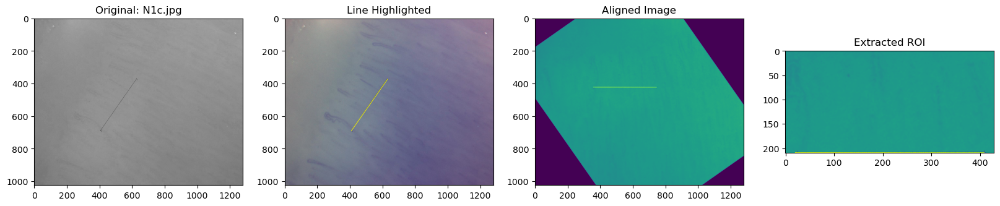

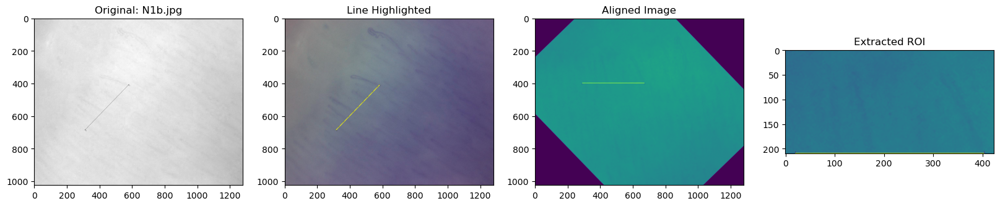

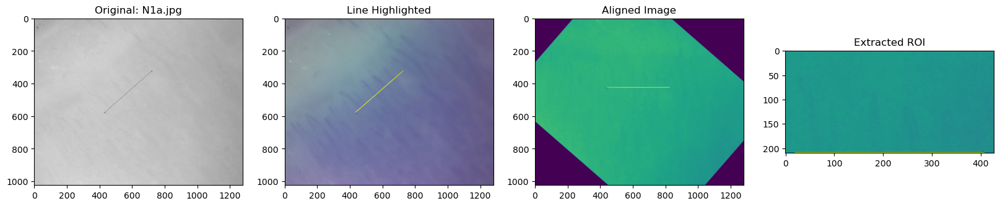

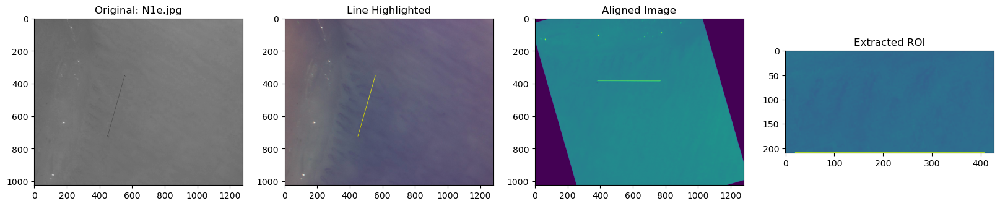

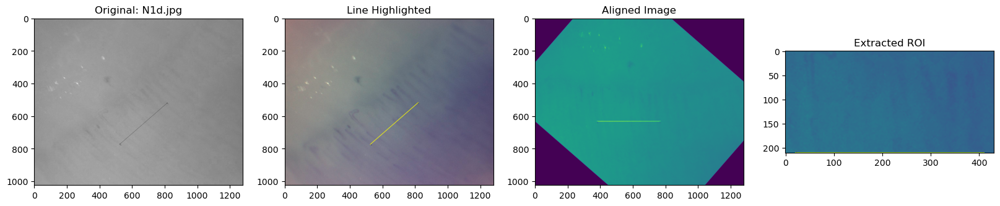

...

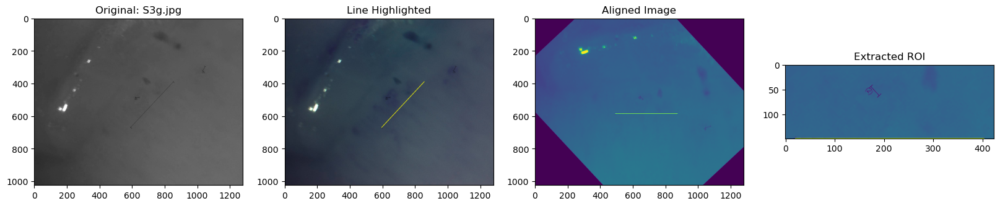

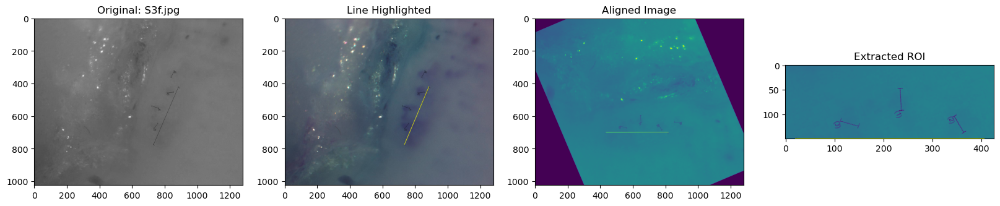

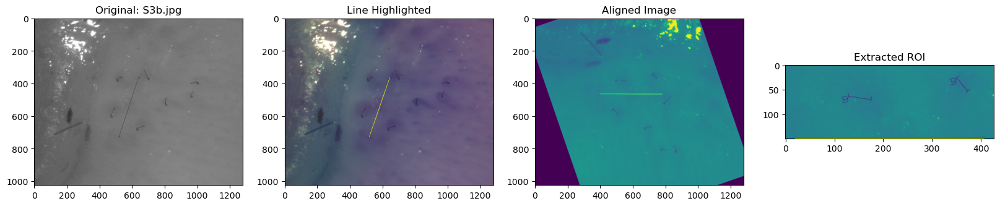

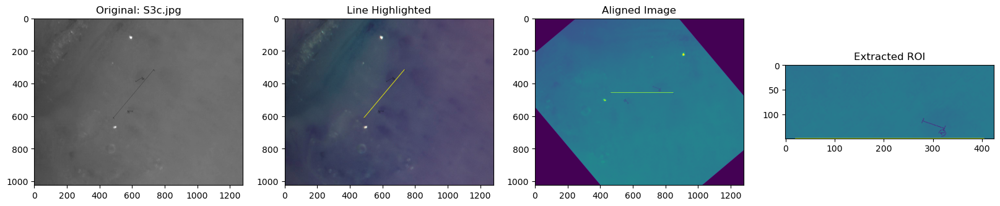

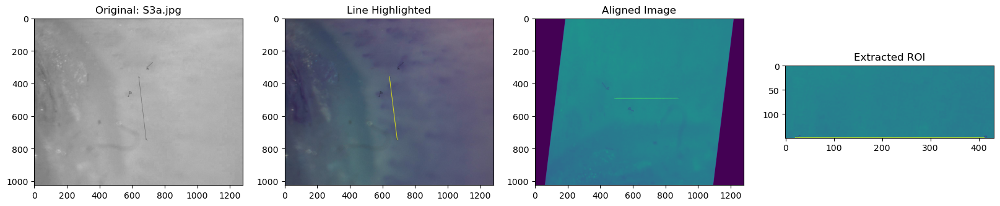

In [3]:
# Containers for image relationships and transformation data
file_link_map = {}
rotation_data = {}

# Directory and folder structure
data_root = r'data'
sub_dirs = ['N1', 'N2', 'S2', 'S3']
all_image_paths = []
natifs = []

# Collect image paths and map non-natif to natif variants
for sub in sub_dirs:
    path_to_sub = os.path.join(data_root, sub)
    for img in os.listdir(path_to_sub):
        full_img_path = os.path.join(path_to_sub, img)
        all_image_paths.append(full_img_path)
        if '_Natif' in full_img_path:
            paired_path = full_img_path.replace('_Natif', '')
            file_link_map[paired_path] = full_img_path

# Image processing loop
for img_path in all_image_paths:
    if '_Natif' in img_path:
        continue

    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    red_channel = img_bgr[:, :, 2]

    # Parameters for Canny + Hough transform
    low_thresh = 30
    high_thresh = 90
    blur_size = (5, 5)
    rho_val = 1
    theta_val = np.pi / 180
    line_thresh = 100
    min_len = 100
    max_gap = 100

    # Edge detection and line extraction
    blurred_img = cv2.GaussianBlur(red_channel, blur_size, 0)
    detected_edges = cv2.Canny(blurred_img, low_thresh, high_thresh)
    line_segments = cv2.HoughLinesP(detected_edges, rho_val, theta_val, line_thresh, minLineLength=min_len, maxLineGap=max_gap)

    if line_segments is None:
        continue

    # Choose the longest line segment
    major_line = max(line_segments, key=lambda ln: np.hypot(ln[0][2]-ln[0][0], ln[0][3]-ln[0][1]))
    line_overlay = img_bgr.copy().astype(np.uint8)
    cv2.line(line_overlay, (major_line[0][0], major_line[0][1]), (major_line[0][2], major_line[0][3]), (255, 255, 0), 2)

    delta_x = major_line[0][2] - major_line[0][0]
    delta_y = major_line[0][3] - major_line[0][1]
    line_slope = delta_y / delta_x if delta_x != 0 else np.inf

    raw_angle = np.degrees(np.arctan(line_slope))
    if delta_x < 0:
        raw_angle += 180
    corrected_angle = raw_angle - 90

    rotated_img, rot_matrix = rotate_to_horizontal(red_channel, corrected_angle)

    original_pts = np.float32([[major_line[0][0], major_line[0][1]], [major_line[0][2], major_line[0][3]]]).reshape(-1, 1, 2)
    new_pts = cv2.transform(original_pts, rot_matrix)
    updated_line = new_pts.reshape(-1, 4).astype(int)

    region = get_roi(rotated_img, updated_line, img_path)

    if region is not None:
        img_name = os.path.basename(img_path)
        fig, axes = plt.subplots(1, 4, figsize=(20, 10))

        axes[0].imshow(red_channel, cmap='gray')
        axes[0].set_title(f"Original: {img_name}")

        axes[1].imshow(line_overlay)
        axes[1].set_title("Line Highlighted")

        cv2.line(rotated_img, (updated_line[0][0], updated_line[0][1]), (updated_line[0][2], updated_line[0][3]), (255, 0, 255), 2)
        axes[2].imshow(rotated_img)
        axes[2].set_title("Aligned Image")

        axes[3].imshow(region)
        axes[3].set_title("Extracted ROI")

        plt.show()

    rotation_data[img_path] = (corrected_angle, updated_line)


# Extracting Green Channel

In [5]:
rois_natif = []
# Loop through each non-natif and its associated natif image
for original_path, natif_version in file_link_map.items():
    natif_bgr = cv2.imread(natif_version)  # Load the color image (natif)

    angle_val, adjusted_line = rotation_data[original_path]
    rotated_natif_img, natif_rot_matrix = rotate_to_horizontal(natif_bgr, angle_val)  # Rotate in color space
    roi_from_natif = get_roi(rotated_natif_img, adjusted_line, natif_version)  # Extract ROI from rotated natif image

    if roi_from_natif is not None:
        green_roi = roi_from_natif[:, :, 1]  # Extract green channel
        rois_natif.append(green_roi)


# Visualization

Total extracted ROIs: 30


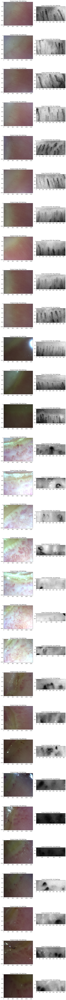

In [6]:
# Display ROIs and their original natif images side-by-side
total_rois = len(rois_natif)
print(f"Total extracted ROIs: {total_rois}")

fig, axes_grid = plt.subplots(total_rois, 2, figsize=(10, 5 * total_rois))

for i, (natif_file, green_crop) in enumerate(zip(file_link_map.values(), rois_natif)):
    original_img = cv2.imread(natif_file)
    rgb_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)  # Convert to RGB for display

    axes_grid[i, 0].imshow(rgb_img)
    axes_grid[i, 0].set_title(f"Original Image: {os.path.basename(natif_file)}")

    axes_grid[i, 1].imshow(green_crop, cmap='gray')
    axes_grid[i, 1].set_title(f"Green Channel ROI: {os.path.basename(natif_file)}")

plt.tight_layout()
plt.show()


# Luminance Calculation

In [21]:
# Extract the list of natif image paths from the mapping dictionary
natif_image_list = list(file_link_map.values())

# Loop through each ROI and its corresponding image path to compute luminance
for idx, (green_roi, natif_img_path) in enumerate(zip(rois_natif, natif_image_list)):
    brightness_value = calculate_luminance(green_roi)
    file_label = os.path.basename(natif_img_path)
    print(f"Luminance of {file_label}: {brightness_value}")


Luminance of N1b_Natif.jpg: 124.45604222821204
Luminance of N1d_Natif.jpg: 122.28176997016904
Luminance of N1i_Natif.jpg: 96.94706743217381
Luminance of N1c_Natif.jpg: 129.33213453213455
Luminance of N1e_Natif.jpg: 92.77545616377392
Luminance of N1h_Natif.jpg: 117.47603471295061
Luminance of N1f_Natif.jpg: 106.24676034348165
Luminance of N1a_Natif.jpg: 140.32089452603472
Luminance of N1g_Natif.jpg: 106.24676034348165
Luminance of N1j_Natif.jpg: 102.92969778075164
Luminance of N2c_Natif.jpg: 79.30318207282913
Luminance of N2d_Natif.jpg: 74.4789131652661
Luminance of N2b_Natif.jpg: 65.20729411764705
Luminance of S2d_Natif.jpg: 154.7188473520249
Luminance of S2b_Natif.jpg: 215.3745882352941
Luminance of S2e_Natif.jpg: 202.81131782945735
Luminance of S2c_Natif.jpg: 216.00922118380063
Luminance of S2f_Natif.jpg: 208.72426791277258
Luminance of S2g_Natif.jpg: 190.15661467359908
Luminance of S2a_Natif.jpg: 199.92108380592313
Luminance of S3f_Natif.jpg: 83.97131455399061
Luminance of S3a_Natif

# Capillary Detection & Counting

Luminance for N1b_Natif.jpg: 124.45604222821204
19


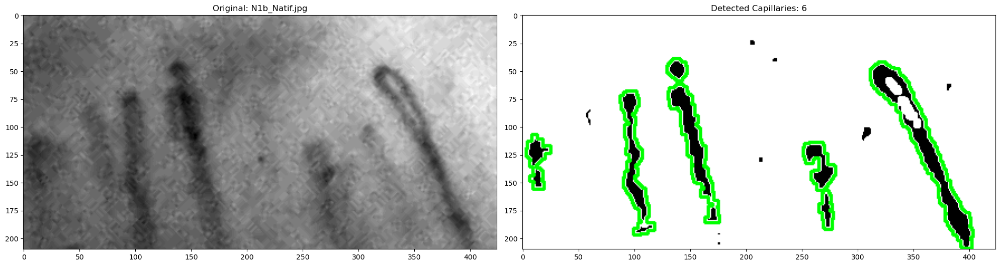

Luminance for N1d_Natif.jpg: 122.28176997016904
42


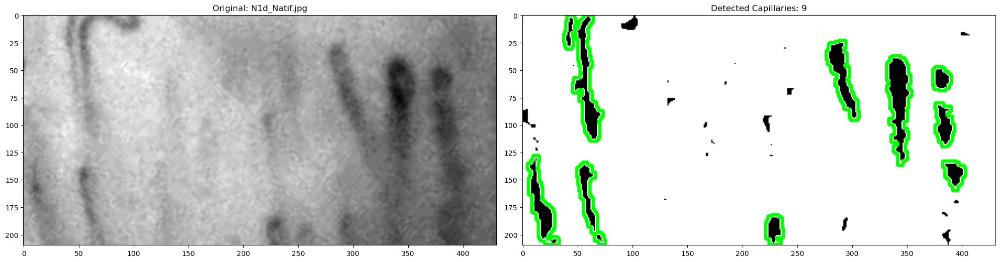

Luminance for N1i_Natif.jpg: 96.94706743217381
22


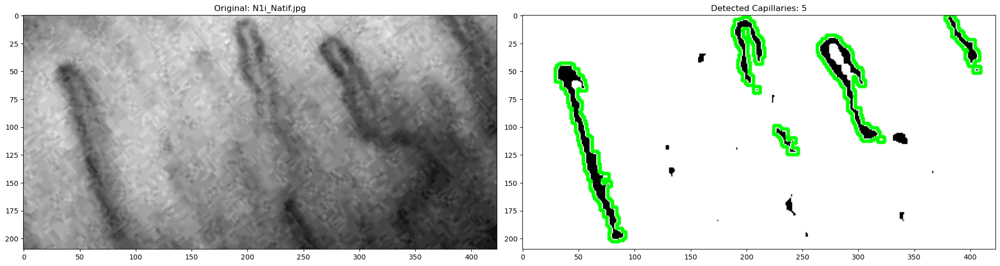

Luminance for N1c_Natif.jpg: 129.33213453213455
32


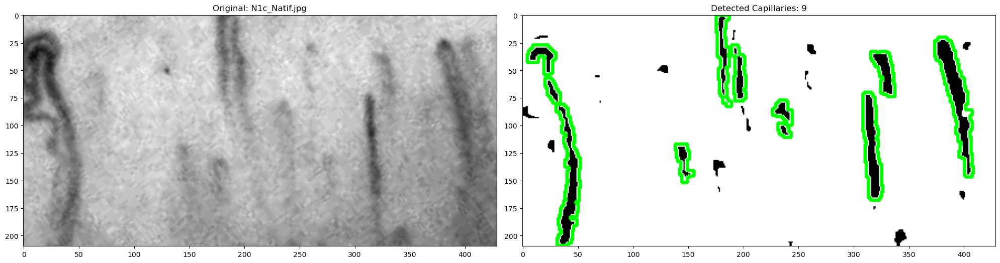

Luminance for N1e_Natif.jpg: 92.77545616377392
33


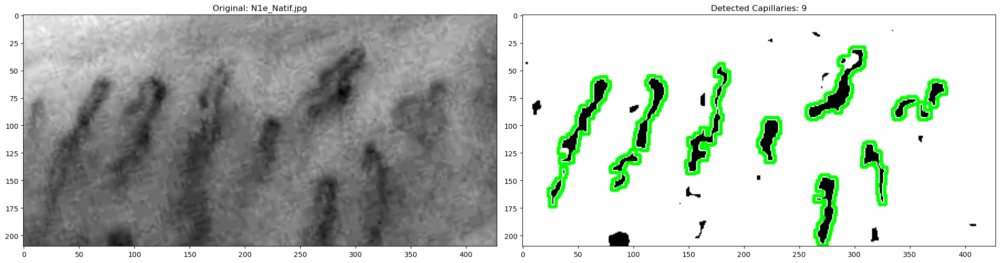

Luminance for N1h_Natif.jpg: 117.47603471295061
33


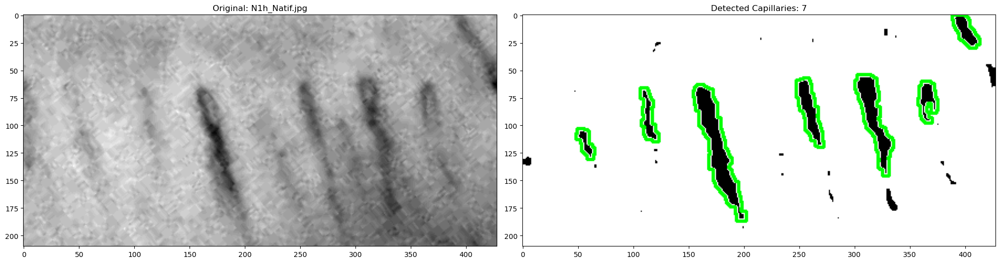

Luminance for N1f_Natif.jpg: 106.24676034348165
28


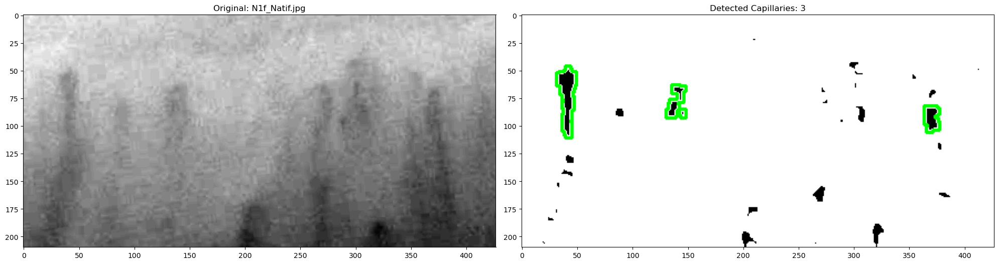

Luminance for N1a_Natif.jpg: 140.32089452603472
17


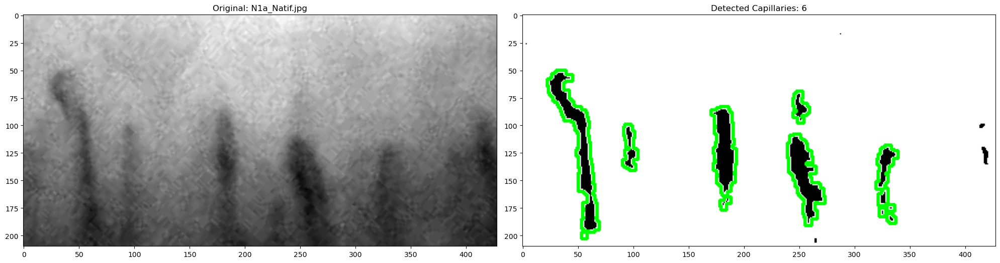

Luminance for N1g_Natif.jpg: 106.24676034348165
28


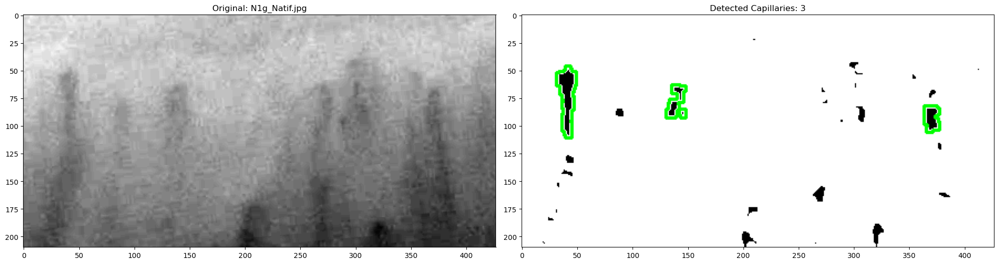

Luminance for N1j_Natif.jpg: 102.92969778075164
27


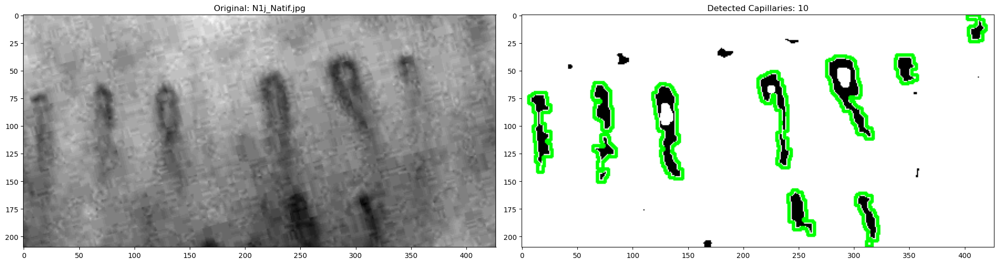

Luminance for N2c_Natif.jpg: 79.30318207282913
33


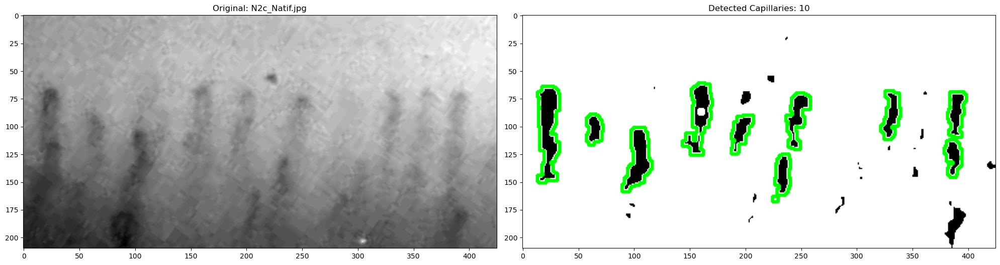

Luminance for N2d_Natif.jpg: 74.4789131652661
38


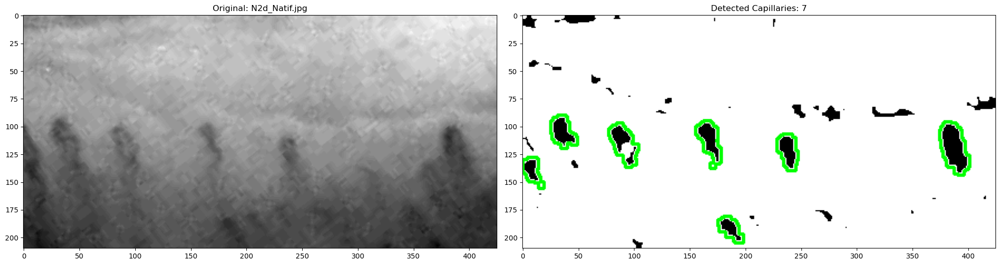

Luminance for N2b_Natif.jpg: 65.20729411764705
63


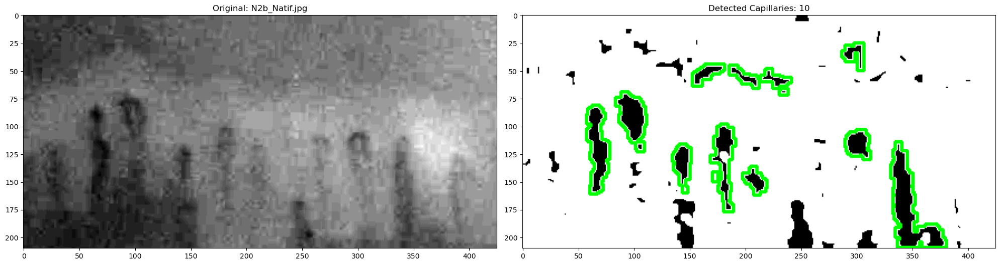

Luminance for S2d_Natif.jpg: 154.7188473520249
36


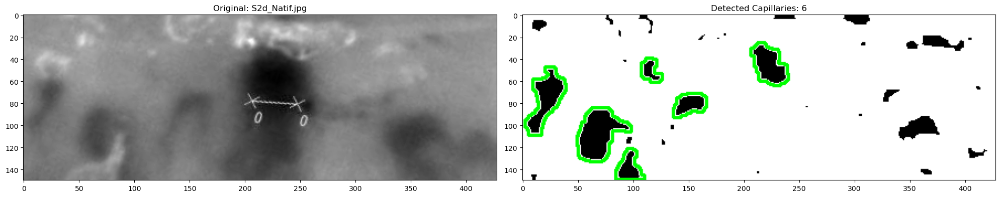

Luminance for S2b_Natif.jpg: 215.3745882352941
28


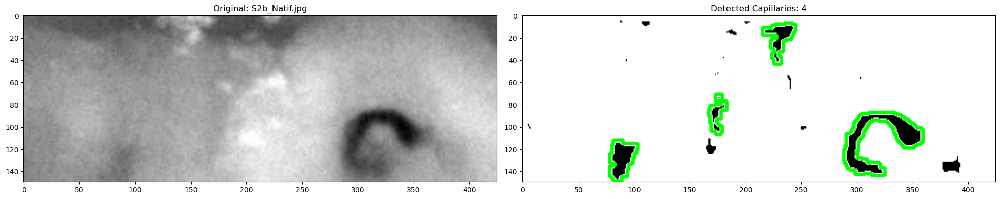

Luminance for S2e_Natif.jpg: 202.81131782945735
22


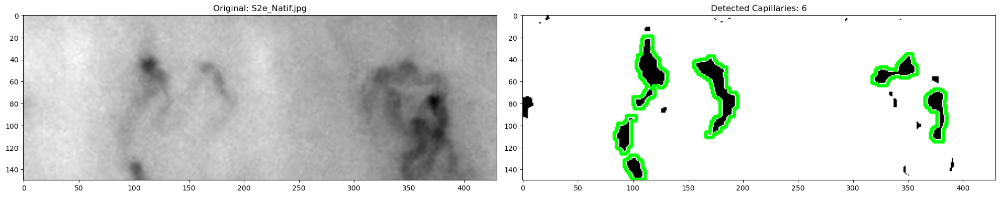

Luminance for S2c_Natif.jpg: 216.00922118380063
28


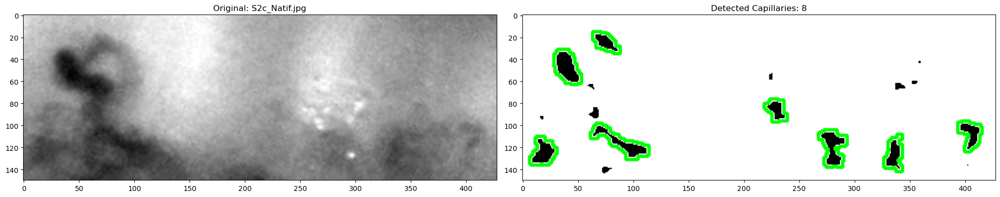

Luminance for S2f_Natif.jpg: 208.72426791277258
28


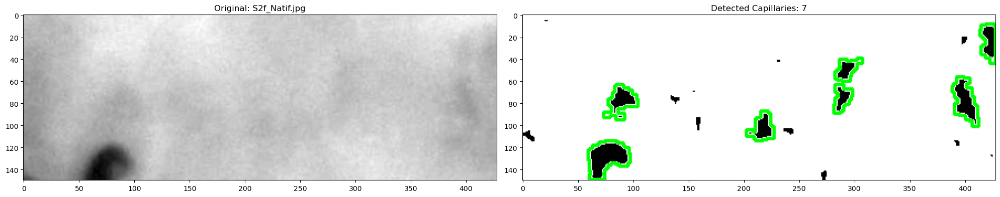

Luminance for S2g_Natif.jpg: 190.15661467359908
27


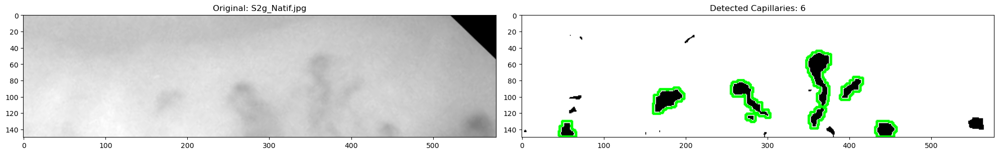

Luminance for S2a_Natif.jpg: 199.92108380592313
41


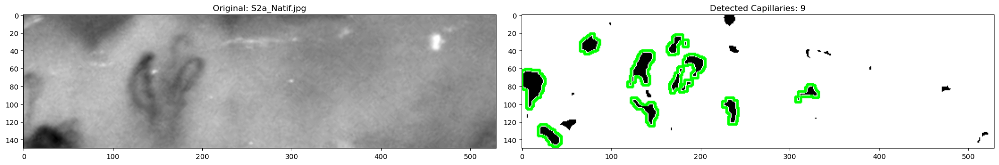

Luminance for S3f_Natif.jpg: 83.97131455399061
15


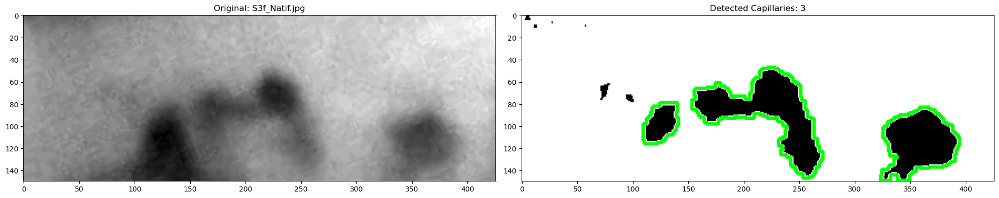

Luminance for S3a_Natif.jpg: 93.61689814814815
8


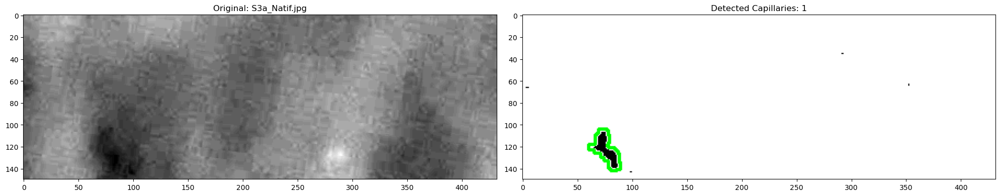

Luminance for S3g_Natif.jpg: 64.50977987421383
14


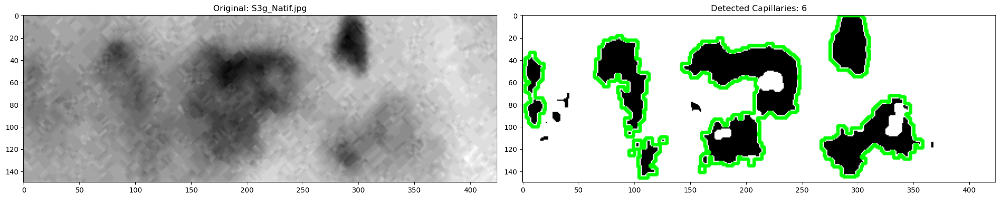

Luminance for S3j_Natif.jpg: 76.04064465408806
27


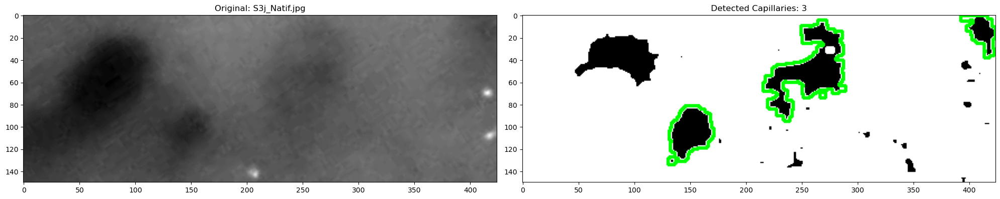

Luminance for S3b_Natif.jpg: 87.8912724434036
16


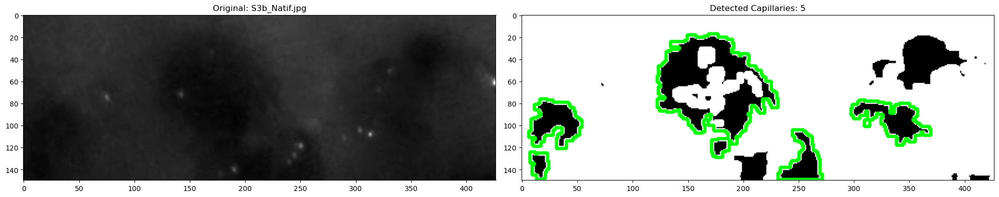

Luminance for S3d_Natif.jpg: 84.11505030181087
19


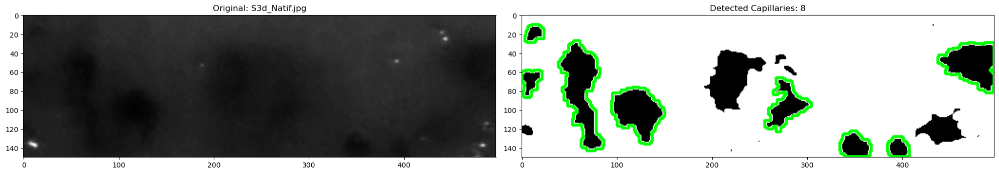

Luminance for S3i_Natif.jpg: 73.8383962264151
20


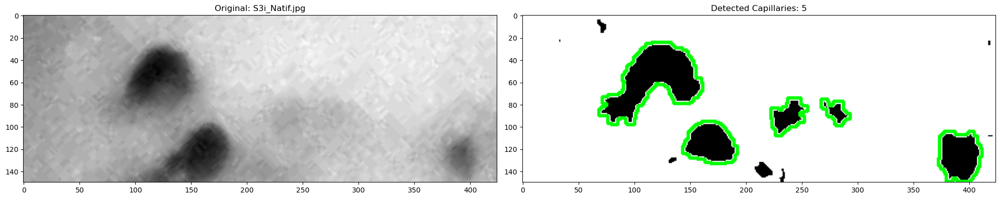

Luminance for S3c_Natif.jpg: 77.30483137254902
49


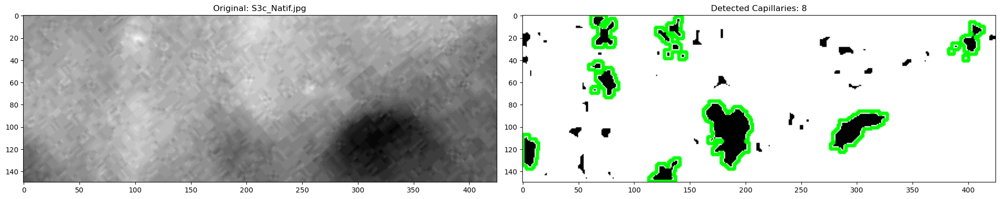

Luminance for S3e_Natif.jpg: 69.29553459119496
20


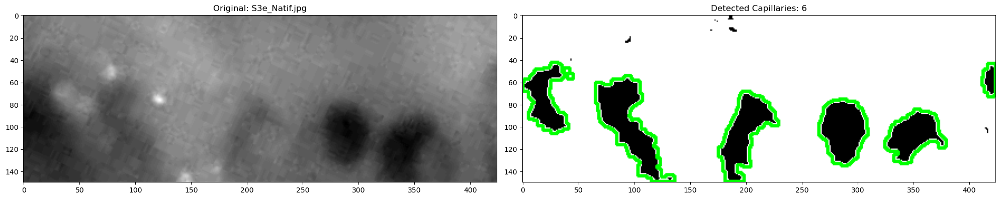

Luminance for S3h_Natif.jpg: 50.61941823899371
40


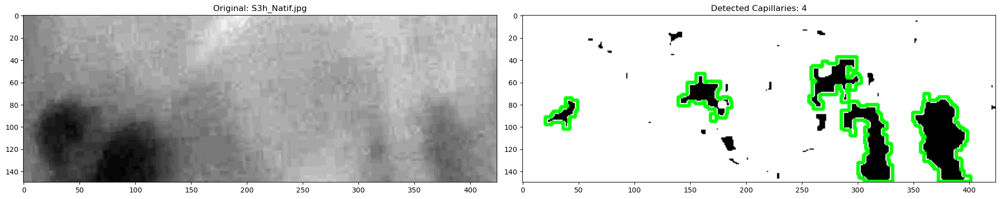

In [19]:
# Prepare the list of natif image file paths
natif_paths = list(file_link_map.values())

# Run the capillary analysis on green-channel ROIs
analysis_results = analyze_images(rois_natif, natif_paths)


# Capillary Count per Image

In [20]:
# Print summary of capillary counts for each image
for filename, count in analysis_results.items():
    print(f"{filename}: {count} capillaries detected")


N1b_Natif.jpg: 6 capillaries detected
N1d_Natif.jpg: 9 capillaries detected
N1i_Natif.jpg: 5 capillaries detected
N1c_Natif.jpg: 9 capillaries detected
N1e_Natif.jpg: 9 capillaries detected
N1h_Natif.jpg: 7 capillaries detected
N1f_Natif.jpg: 3 capillaries detected
N1a_Natif.jpg: 6 capillaries detected
N1g_Natif.jpg: 3 capillaries detected
N1j_Natif.jpg: 10 capillaries detected
N2c_Natif.jpg: 10 capillaries detected
N2d_Natif.jpg: 7 capillaries detected
N2b_Natif.jpg: 10 capillaries detected
S2d_Natif.jpg: 6 capillaries detected
S2b_Natif.jpg: 4 capillaries detected
S2e_Natif.jpg: 6 capillaries detected
S2c_Natif.jpg: 8 capillaries detected
S2f_Natif.jpg: 7 capillaries detected
S2g_Natif.jpg: 6 capillaries detected
S2a_Natif.jpg: 9 capillaries detected
S3f_Natif.jpg: 3 capillaries detected
S3a_Natif.jpg: 1 capillaries detected
S3g_Natif.jpg: 6 capillaries detected
S3j_Natif.jpg: 3 capillaries detected
S3b_Natif.jpg: 5 capillaries detected
S3d_Natif.jpg: 8 capillaries detected
S3i_Natif

# Comparision with Ground Truth 

In [ ]:
# Reference capillary counts manually labeled
reference_counts = {
    'N1a': 6, 'N1b': 7, 'N1c': 9, 'N1d': 8, 'N1e': 8, 'N1f': 9, 'N1g': 9, 'N1h': 7, 'N1i': 7, 'N1j': 8,
    'N2b': 10, 'N2c': 9, 'N2d': 7, 'S2a': 1, 'S2b': 2, 'S2c': 2, 'S2d': 5, 'S2e': 4, 'S2f': 1, 'S2g': 4,
    'S3a': 5, 'S3b': 5, 'S3c': 2, 'S3d': 5, 'S3e': 5, 'S3f': 4, 'S3g': 5, 'S3h': 4, 'S3i': 2, 'S3j': 5
}

# Results estimated by the image processing algorithm
estimated_counts = {
    'N1a': 7, 'N1b': 6, 'N1c': 11, 'N1d': 13, 'N1e': 10, 'N1f': 7, 'N1g': 7, 'N1h': 13, 'N1i': 6, 'N1j': 11,
    'N2b': 7, 'N2c': 10, 'N2d': 7, 'S2a': 8, 'S2b': 8, 'S2c': 9, 'S2d': 21, 'S2e': 9, 'S2f': 7, 'S2g': 10,
    'S3a': 6, 'S3b': 5, 'S3c': 2, 'S3d': 11, 'S3e': 5, 'S3f': 7, 'S3g': 9, 'S3h': 8, 'S3i': 5, 'S3j': 3
}

# Count how many predictions match the reference exactly
matching_entries = sum(reference_counts[k] == estimated_counts.get(k, -1) for k in reference_counts)
total_samples = len(reference_counts)
matching_ratio = matching_entries / total_samples

print(f"Prediction Agreement: {matching_ratio * 100:.2f}%")

# #It is a measure for deviation from the detected cappilaries from the provided ground truth"
#it's just a measure of closeness to manual annotation, not classification accuracy.


Prediction Agreement: 13.33%


# Standard Deviation

In [17]:
# Convert reference and estimated counts to NumPy arrays
true_counts_array = np.array(list(reference_counts.values()))
estimated_counts_array = np.array(list(estimated_counts.values()))

# Calculate the difference and its spread
count_differences = true_counts_array - estimated_counts_array
spread_std_dev = np.std(count_differences)

print(f"Standard Deviation of Differences: {spread_std_dev:}")


Standard Deviation of Differences: 3.8616346567512343
